In [1]:
from google.colab import drive
drive.mount('/content/drive')

data_dir   = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset"

Mounted at /content/drive


# Realistic Vision v51

In [2]:
from IPython.display import display

import os
from PIL import Image

data_dir   = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset"
categories = ["bathroom", "bedroom", "living_room"]

for cat in categories:
    cat_path = os.path.join(data_dir, cat)
    for fname in os.listdir(cat_path):
        if not fname.lower().endswith(".png"):
            continue

        image_path = os.path.join(cat_path, fname)
        print(f"image found in '{cat}': {fname}")

        # Load + resize
        image = Image.open(image_path).convert("RGB")
        image = image.resize((512, 512))

image found in 'bathroom': 0126-0009_1.png
image found in 'bathroom': 0126-0009_4.png
image found in 'bathroom': 0126-0009_2.png
image found in 'bathroom': 0126-0009_3.png
image found in 'bedroom': 0001-0040_1.png
image found in 'bedroom': 0001-0040_3.png
image found in 'bedroom': 0001-0040_4.png
image found in 'bedroom': 0001-0040_2.png
image found in 'living_room': 0128-0104_1.png
image found in 'living_room': 0128-0104_5.png
image found in 'living_room': 0128-0104_3.png
image found in 'living_room': 0128-0104_2.png
image found in 'living_room': 0128-0104_4.png
image found in 'living_room': 0128-0104_6.png


**bathroom – 0126-0009_1.png**

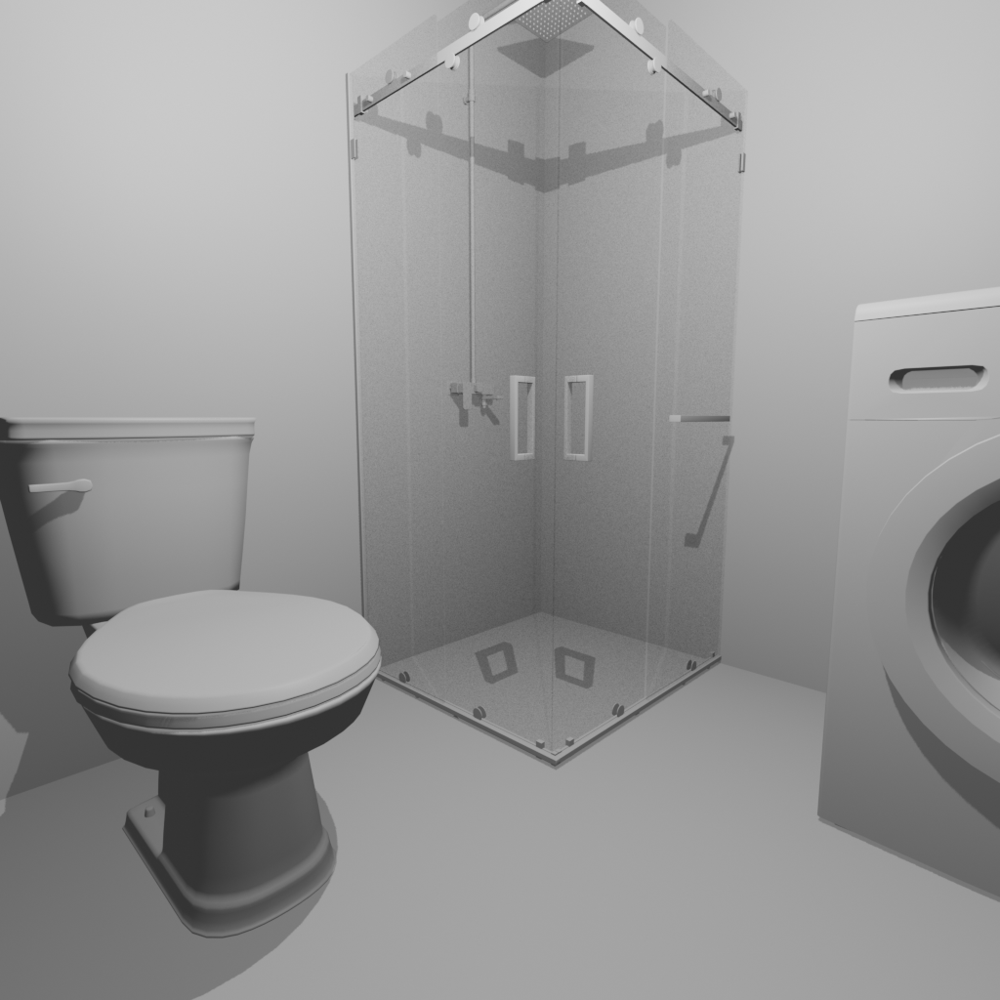

**bedroom – 0001-0040_1.png**

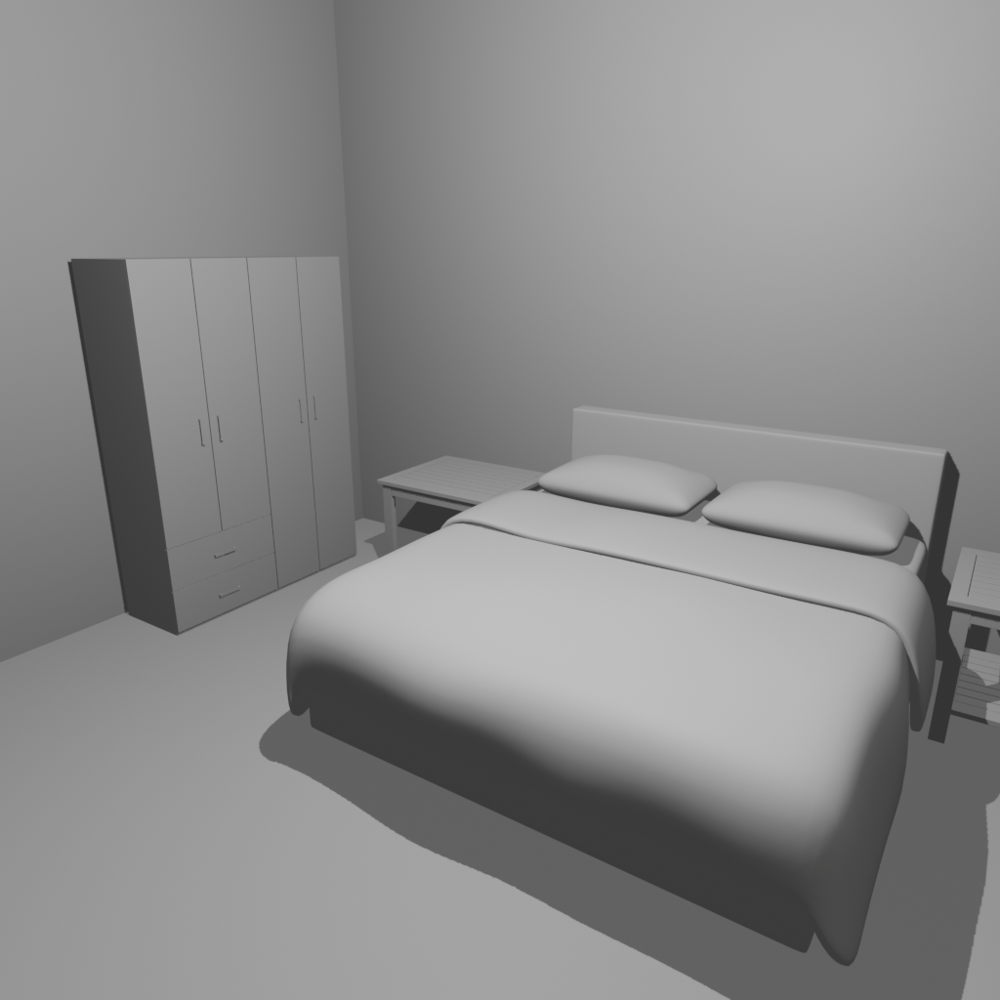

**living_room – 0128-0104_1.png**

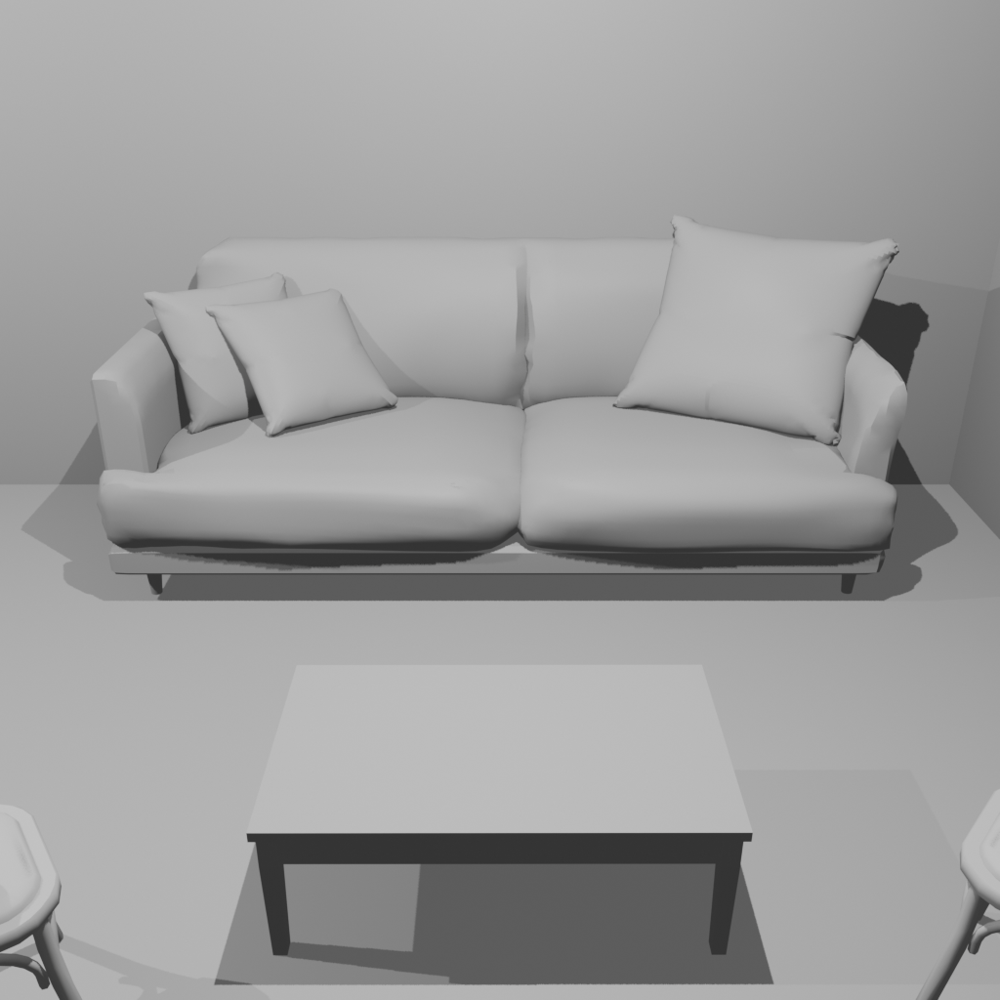

In [3]:
import os
from PIL import Image
from IPython.display import display, Markdown

data_dir   = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset"
categories = ["bathroom", "bedroom", "living_room"]

for cat in categories:
    cat_path = os.path.join(data_dir, cat)
    for fname in sorted(os.listdir(cat_path)):
        if not fname.lower().endswith(".png"):
            continue

        # Load
        image_path = os.path.join(cat_path, fname)
        img = Image.open(image_path).convert("RGB")

        # Display title + image
        display(Markdown(f"**{cat} – {fname}**"))
        display(img)

        break

In [ ]:
!pip install diffusers transformers accelerate
!pip install xformers --prefer-binary

In [ ]:
from huggingface_hub import login
login()

In [ ]:
!pip install --upgrade \
  --extra-index-url https://download.pytorch.org/whl/cu126 \
  torch==2.7.0 torchvision==0.22.0+cu126

Looking in indexes: https://pypi.org/simple, https://download.pytorch.org/whl/cu126
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 867.0/867.0 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 115.2 MB/s eta 0:00:00
  Attempting uninstall: torch
    Found existing installation: torch 2.7.0
    Uninstalling torch-2.7.0:
      Successfully uninstalled torch-2.7.0
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.21.0+cu124
    Uninstalling torchvision-0.21.0+cu124:
      Successfully uninstalled torchvision-0.21.0+cu124
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
fastai 2.7.19 requires torch<2.7,>=1.10, but you have torch 2.7.0+cu126 which is incompatible.
torchaudio 2.6.0+cu124 requires torch==2.6.0, but you have torch 2.7.0+cu126 which is incompatible.


In [ ]:
import torch, torchvision
print(torch.__version__, torchvision.__version__)

2.7.0+cu126 0.22.0+cu126


In [ ]:
import torchvision.ops as ops
print(hasattr(ops, "nms"))

True


In [ ]:
from diffusers import StableDiffusionImg2ImgPipeline

pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "stablediffusionapi/realistic-vision-v51",
    torch_dtype=torch.float16,
).to("cuda")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/84 [00:00<?, ?it/s]

  0%|          | 0/108 [00:00<?, ?it/s]

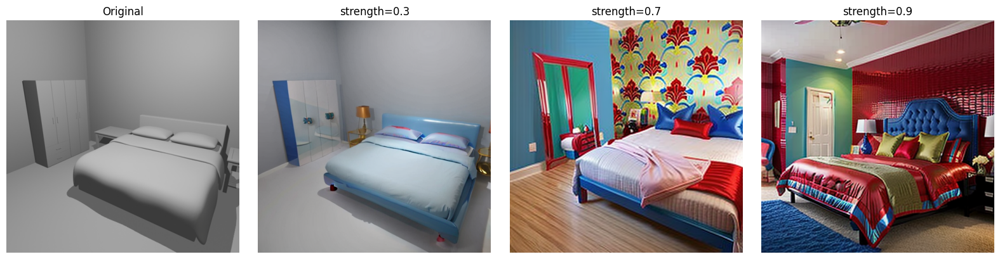

In [ ]:
import os
from PIL import Image
import torch
from diffusers import StableDiffusionImg2ImgPipeline
import matplotlib.pyplot as plt

# 1) Load & prepare the original image
data_dir = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset"
cat      = "bedroom"
fname    = "0001-0040_1.png"
image_path = os.path.join(data_dir, cat, fname)

orig = Image.open(image_path).convert("RGB")
orig = orig.resize((512, 512))

# 2) (Re)instantiate your pipeline if needed
pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "stablediffusionapi/realistic-vision-v51",
    torch_dtype=torch.float16,
).to("cuda")

# 3) Define prompts & constant params
prompt          = "glossy bright red wallpaper and a blue bed"
negative_prompt = "blurry, deformed, text, watermark, monochrome, white"
guidance_scale  = 40
num_steps       = 120

# 4) Loop over strengths and collect outputs
strengths = [0.3, 0.7, 0.9]
results   = [( "Original", orig )]

for s in strengths:
    out = pipe(
        prompt=prompt,
        image=orig,
        strength=s,
        guidance_scale=guidance_scale,
        num_inference_steps=num_steps,
        negative_prompt=negative_prompt
    ).images[0]
    results.append((f"strength={s}", out))

# 5) Display side-by-side with matplotlib
fig, axes = plt.subplots(1, len(results), figsize=(4 * len(results), 4))
for ax, (title, img) in zip(axes, results):
    ax.imshow(img)
    ax.set_title(title)
    ax.axis("off")
plt.tight_layout()
plt.show()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/42 [00:00<?, ?it/s]

  0%|          | 0/42 [00:00<?, ?it/s]

  0%|          | 0/42 [00:00<?, ?it/s]

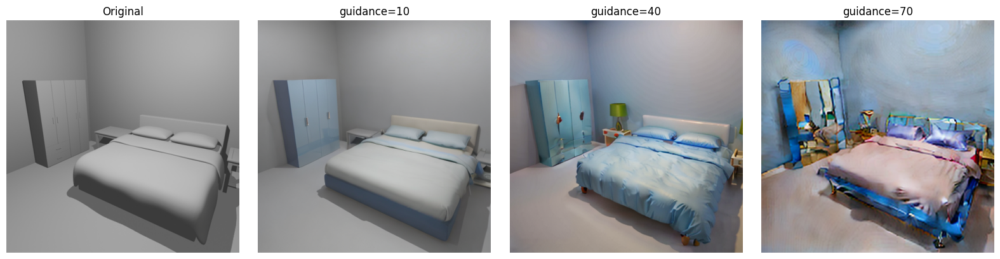

In [ ]:
import os
from PIL import Image
import torch
from diffusers import StableDiffusionImg2ImgPipeline
import matplotlib.pyplot as plt

# 1) Load & prepare your original image
data_dir = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset"
cat      = "bedroom"
fname    = "0001-0040_1.png"
image_path = os.path.join(data_dir, cat, fname)

orig = Image.open(image_path).convert("RGB")
orig = orig.resize((512, 512))

# 2) (Re)instantiate your pipeline if you haven’t already
pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "stablediffusionapi/realistic-vision-v51",
    torch_dtype=torch.float16,
).to("cuda")

# 3) Set up prompt & constant parameters
prompt          = "glossy bright red wallpaper and a blue bed"
negative_prompt = "blurry, deformed, text, watermark, monochrome, white"
strength        = 0.35    # fixed
num_steps       = 120

# 4) Loop over guidance scales
guidance_scales = [10, 40, 70]
results = [("Original", orig)]

for g in guidance_scales:
    out = pipe(
        prompt=prompt,
        image=orig,
        strength=strength,
        guidance_scale=g,
        num_inference_steps=num_steps,
        negative_prompt=negative_prompt
    ).images[0]
    results.append((f"guidance={g}", out))

# 5) Display side-by-side
fig, axes = plt.subplots(1, len(results), figsize=(4 * len(results), 4))
for ax, (title, img) in zip(axes, results):
    ax.imshow(img)
    ax.set_title(title)
    ax.axis("off")
plt.tight_layout()
plt.show()

  0%|          | 0/27 [00:00<?, ?it/s]

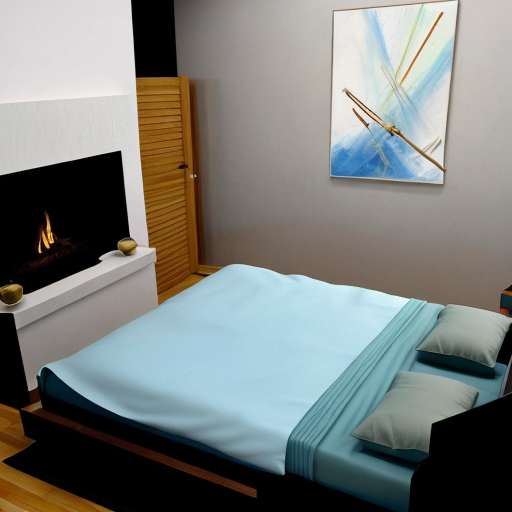

In [ ]:
prompt = "A modern and minimalist bedroom with abstract artwork hanging from the wal, bamboo door, raging fireplace at the foot of the bed, hyperrealistic, high resolution, IMAX, best quality"
negative_prompt = "blurry, deformed, watermark, white walls, monochrome, tv, television"

output = pipe(
    prompt=prompt,
    image=image,
    strength=0.55,
    guidance_scale=12,
    num_inference_steps=50,
    negative_prompt=negative_prompt
).images[0]

output.save("output.png")
display(output)

  0%|          | 0/37 [00:00<?, ?it/s]

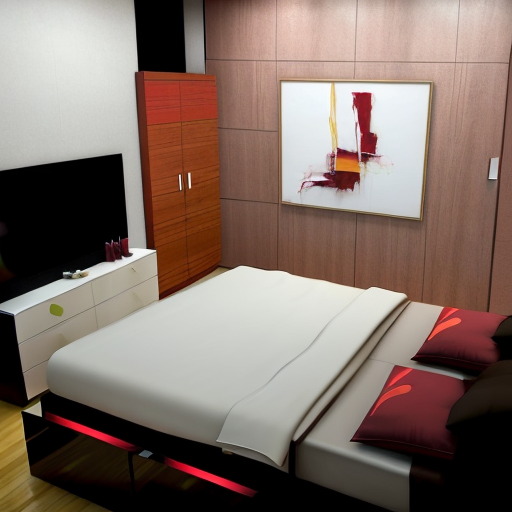

In [ ]:
prompt = "A modern and minimalist bedroom with abstract artwork hanging from the wall, \
maroon colored bed sheets, maroon colored duvet, bamboo door, hyperrealistic, \
dresser at the front of the bed, \
high resolution, IMAX, best quality, preserver the layout at all cost"
negative_prompt = "blurry, deformed, watermark, white walls, monochrome, blue bed, blue sheets, double bed, 4 pillows"

output = pipe(
    prompt=prompt,
    image=image,
    strength=0.62,
    guidance_scale=17,
    num_inference_steps=60,
    negative_prompt=negative_prompt
).images[0]

output.save("output.png")
display(output)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

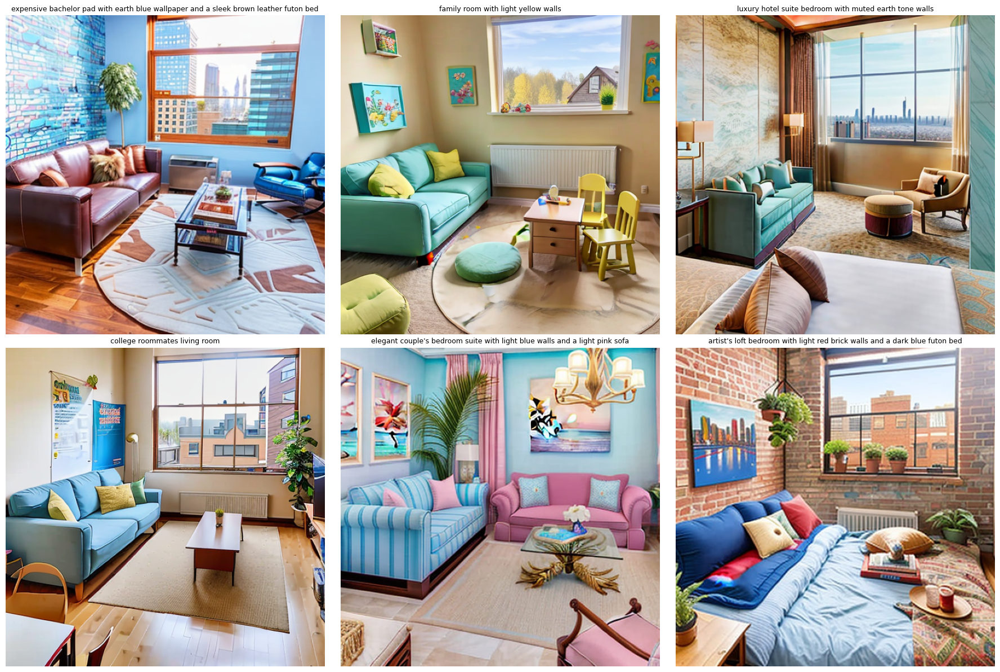

In [ ]:
import os
from PIL import Image, ImageEnhance
import torch
from diffusers import StableDiffusionImg2ImgPipeline
import matplotlib.pyplot as plt

# 1) Load & enhance image
data_dir = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset"
cat      = "living_room"
fname    = "0128-0104_2.png"
image_path = os.path.join(data_dir, cat, fname)

image = Image.open(image_path).convert("RGB").resize((512, 512))
image = ImageEnhance.Contrast(image).enhance(1.8)

# 2) Instantiate the pipeline (if not already)
pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "stablediffusionapi/realistic-vision-v51",
    torch_dtype=torch.float16,
).to("cuda")

# 3) Fixed parameters
strength         = 0.62
num_inference_steps = 50
negative_prompt  = "monochrome, grayscale, blurry, washed out, deformed, white walls, low saturation, person, people, human, face, portrait"

# 4) Customer-themed prompts
themes = [
    # 1. Bachelor pad
    "expensive bachelor pad with earth blue wallpaper and a sleek brown leather futon bed, industrial loft vibe, city skyline visible through large window",

    # 2. Family with kids
    "family room with light yellow walls, children's toys and family photos, sunny green backyard visible through window",

    # 3. Luxury hotel suite
    "luxury hotel suite bedroom with muted earth tone walls, light teal bedding, marble accents, urban skyline view through floor‐to‐ceiling window",

    # 4. College roomates
    "college roommates living room, posters on walls, suburban street and university building visible through window",

    # 5. Beach house
    "elegant couple's bedroom suite with light blue walls and a light pink sofa, classic furnishings, seashell art, the beach and palm tree visible through window",

    # 6. Artist loft
    "artist's loft bedroom with light red brick walls and a dark blue futon bed, indoor plants, art supplies and books around, cityscape visible through warehouse‐style window"
]

# 5) Generate and display in a 2x3 grid
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
for ax, prompt in zip(axes.flatten(), themes):
    out = pipe(
        prompt=prompt,
        image=image,
        strength=strength,
        guidance_scale=15,            # guidance held constant
        num_inference_steps=num_inference_steps,
        negative_prompt=negative_prompt
    ).images[0]
    ax.imshow(out)
    ax.set_title(prompt.split(",")[0], fontsize=9)
    ax.axis("off")

plt.tight_layout()
plt.show()

# Evaluation Metrics

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

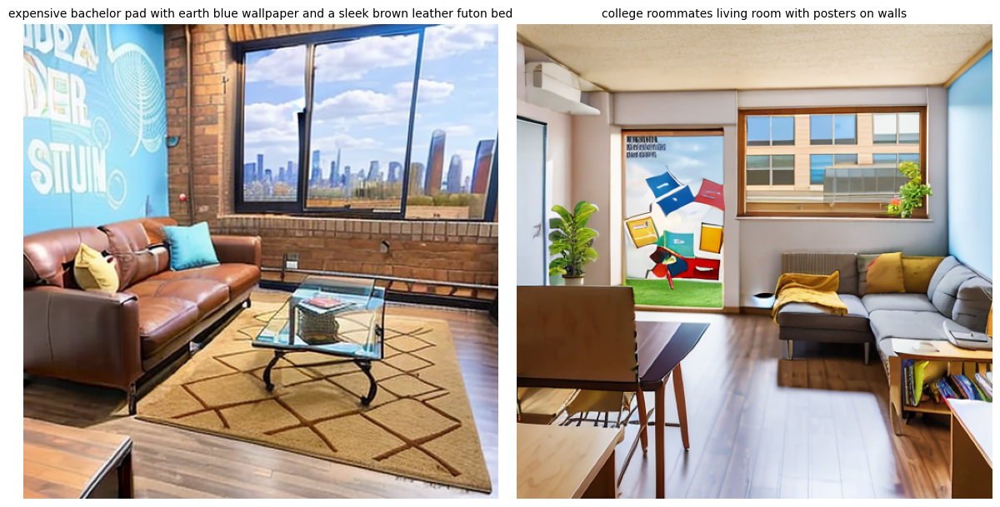

In [ ]:
# Just bachelor pad to run performance metrics

import os
from PIL import Image, ImageEnhance
import torch
from diffusers import StableDiffusionImg2ImgPipeline
import matplotlib.pyplot as plt

# 1) Load & enhance the original
data_dir = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset"
cat, fname = "living_room", "0128-0104_2.png"
orig = Image.open(os.path.join(data_dir, cat, fname)).convert("RGB").resize((512,512))
orig = ImageEnhance.Contrast(orig).enhance(1.8)

# 2) Instantiate pipeline
pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "stablediffusionapi/realistic-vision-v51",
    torch_dtype=torch.float16,
).to("cuda")

# 3) Fixed params
strength            = 0.62
guidance_scale      = 15
num_inference_steps = 50
negative_prompt     = (
    "monochrome, grayscale, blurry, washed out, deformed, "
    "white walls, low saturation, person, people, human, face, portrait"
)

# 4) Exactly two prompts
themes = [
    "expensive bachelor pad with earth blue wallpaper and a sleek brown leather futon bed, industrial loft vibe, city skyline visible through large window",
    "college roommates living room with posters on walls, suburban street and university building visible through window"
]

# 5) Generate and collect outputs
outputs = []
for prompt in themes:
    out = pipe(
        prompt=prompt,
        image=orig,
        strength=strength,
        guidance_scale=guidance_scale,
        num_inference_steps=num_inference_steps,
        negative_prompt=negative_prompt
    ).images[0]
    outputs.append(out)

# 6) Display side-by-side in a 1×2 grid
fig, axes = plt.subplots(1, len(outputs), figsize=(6 * len(outputs), 6))
for ax, img, prompt in zip(axes, outputs, themes):
    ax.imshow(img)
    ax.set_title(prompt.split(",")[0], fontsize=10)
    ax.axis("off")
plt.tight_layout()
plt.show()

In [ ]:
!pip install lpips

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 3.7 MB/s eta 0:00:00


In [ ]:
!pip install lpips transformers

In [ ]:
import os
import numpy as np
import torch
from PIL import Image
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
import lpips
from transformers import CLIPProcessor, CLIPModel
import torchvision.transforms as T
from torch.nn.functional import cosine_similarity

device = "cuda" if torch.cuda.is_available() else "cpu"

# ─── Models & Transforms ───────────────────────────────────────────────
# LPIPS
lpips_fn = lpips.LPIPS(net='alex').to(device)

# CLIP
clip_model     = CLIPModel.from_pretrained("openai/clip-vit-base-patch32").to(device)
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# for LPIPS: PIL→Tensor in [-1,1]
to_tensor = T.Compose([
    T.ToTensor(),                      # [0,1]
    T.Normalize([0.5]*3, [0.5]*3)      # → [-1,1]
])

# ─── Preload Original ───────────────────────────────────────────────────
orig_img     = orig           # your PIL.Image
orig_arr     = np.array(orig_img)
orig_lpips_t = to_tensor(orig_img).unsqueeze(0).to(device)
orig_clip_in = clip_processor(images=orig_img, return_tensors="pt").to(device)
with torch.no_grad():
    orig_clip_emb = clip_model.get_image_features(**orig_clip_in)

# Loop
for prompt, out_img in zip(themes, outputs):
    title = prompt.split(",")[0]

    # 1) Resize to match
    out_img_resized = out_img.resize(orig_img.size, resample=Image.BILINEAR)

    # 2) Convert to arrays
    out_arr = np.array(out_img_resized)

    # 3) PSNR & SSIM
    psnr_score = peak_signal_noise_ratio(orig_arr, out_arr, data_range=255)
    ssim_score = structural_similarity(
        orig_arr, out_arr,
        channel_axis=2,
        data_range=255,
        win_size=7
    )

    # 4) LPIPS
    out_lpips_t = to_tensor(out_img_resized).unsqueeze(0).to(device)
    lpips_score = lpips_fn(orig_lpips_t, out_lpips_t).item()

    # 5) CLIP cosine similarity
    out_clip_in = clip_processor(images=out_img_resized, return_tensors="pt").to(device)
    with torch.no_grad():
        out_clip_emb = clip_model.get_image_features(**out_clip_in)
    clip_cos_sim = cosine_similarity(orig_clip_emb, out_clip_emb).item()

    # 6) Print
    print(f"{title}\n"
          f"  PSNR : {psnr_score:.2f} dB\n"
          f"  SSIM : {ssim_score:.3f}\n"
          f"  LPIPS: {lpips_score:.3f}\n"
          f"  CLIP : {clip_cos_sim:.3f}\n")

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth
expensive bachelor pad with earth blue wallpaper and a sleek brown leather futon bed
  PSNR : 12.37 dB
  SSIM : 0.469
  LPIPS: 0.835
  CLIP : 0.650

college roommates living room with posters on walls
  PSNR : 12.62 dB
  SSIM : 0.572
  LPIPS: 0.720
  CLIP : 0.723



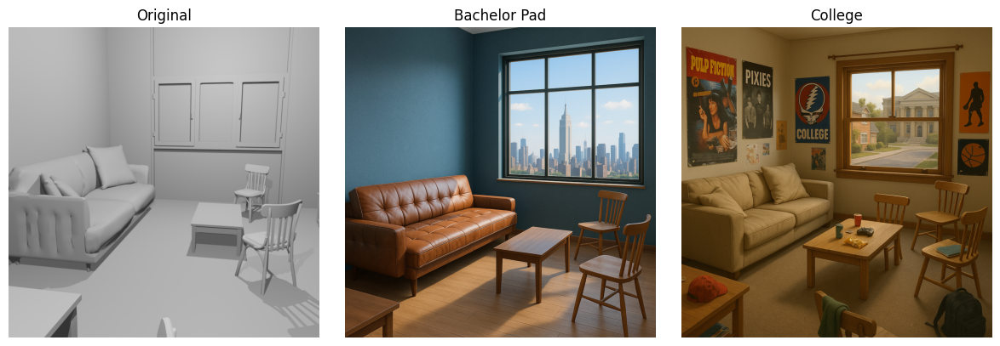

In [ ]:
# Load and display ChatGPT (champion model images) next to original
import os
from PIL import Image
import matplotlib.pyplot as plt

# Define paths
data_dir = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset"
cat, fname = "living_room", "0128-0104_2.png"

orig_path = os.path.join(data_dir, cat, fname)
gen_dir = os.path.join(data_dir, "ChatGPT")
bachelor_path = os.path.join(gen_dir, "bachelorpad.png")
college_path = os.path.join(gen_dir, "college.png")

# Load images
orig = Image.open(orig_path).convert("RGB")
bachelor = Image.open(bachelor_path).convert("RGB")
college = Image.open(college_path).convert("RGB")

# Display side by side
plt.figure(figsize=(12, 4))
for i, (img, title) in enumerate([(orig, "Original"), (bachelor, "Bachelor Pad"), (college, "College")], 1):
    plt.subplot(1, 3, i)
    plt.imshow(img)
    plt.axis("off")
    plt.title(title)
plt.tight_layout()
plt.show()

In [ ]:
!pip install scikit-image lpips torch torchvision transformers

In [ ]:
import os
import torch
import lpips
import numpy as np
from PIL import Image
from skimage.metrics import peak_signal_noise_ratio as compute_psnr
from skimage.metrics import structural_similarity as compute_ssim
from transformers import CLIPProcessor, CLIPModel

# Paths ────────────────────────────────────────────────────────────────
orig_path     = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset/living_room/0128-0104_2.png"
bachelor_path = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset/ChatGPT/bachelorpad.png"
college_path  = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset/ChatGPT/college.png"

generations = [
    ("Bachelor Pad", bachelor_path),
    ("College",      college_path),
]

# Load NumPy images for PSNR/SSIM ───────────────────────────────────────
def load_np(path):
    return np.array(Image.open(path).convert("RGB"))

orig_np = load_np(orig_path)

# Prepare LPIPS model ───────────────────────────────────────────────────
device   = "cuda" if torch.cuda.is_available() else "cpu"
lpips_fn = lpips.LPIPS(net="alex").to(device)

def load_lpips_tensor(path):
    img = lpips.im2tensor(np.array(Image.open(path).convert("RGB")))
    return (img * 2 - 1).to(device)

orig_lpips = load_lpips_tensor(orig_path)

# Prepare CLIP (via Hugging Face) ─────────────────────────────────────
# Load both model & processor—no .load call anywhere!
clip_model     = CLIPModel.from_pretrained("openai/clip-vit-base-patch32").to(device)
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

def encode_clip(path):
    image = Image.open(path).convert("RGB")
    inputs = clip_processor(images=image, return_tensors="pt").to(device)
    return clip_model.get_image_features(**inputs)

orig_clip = encode_clip(orig_path)

# Compute all metrics for each generated image ─────────────────────────
for title, gen_path in generations:
    # PSNR & SSIM
    gen_np = load_np(gen_path)
    assert orig_np.shape == gen_np.shape, f"Size mismatch for {title}"
    psnr_val = compute_psnr(orig_np, gen_np, data_range=255)
    ssim_val = compute_ssim(
    orig_np,
    gen_np,
    channel_axis=2,
    data_range=255,
    win_size=3
)

    # LPIPS
    gen_lpips = load_lpips_tensor(gen_path)
    lpips_val = lpips_fn(orig_lpips, gen_lpips).item()

    # CLIP cosine similarity
    gen_clip_emb = encode_clip(gen_path)
    clip_sim     = torch.nn.functional.cosine_similarity(orig_clip, gen_clip_emb).item()

    print(f"=== {title} ===")
    print(f"PSNR: {psnr_val:.2f} dB")
    print(f"SSIM: {ssim_val:.4f}")
    print(f"LPIPS: {lpips_val:.4f}")
    print(f"CLIP Cosine Similarity: {clip_sim:.4f}\n")

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth
=== Bachelor Pad ===
PSNR: 8.81 dB
SSIM: 0.4437
LPIPS: 0.9255
CLIP Cosine Similarity: 0.8045

=== College ===
PSNR: 7.78 dB
SSIM: 0.4154
LPIPS: 1.0015
CLIP Cosine Similarity: 0.6672



# More experimentation with Realistic Vision

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

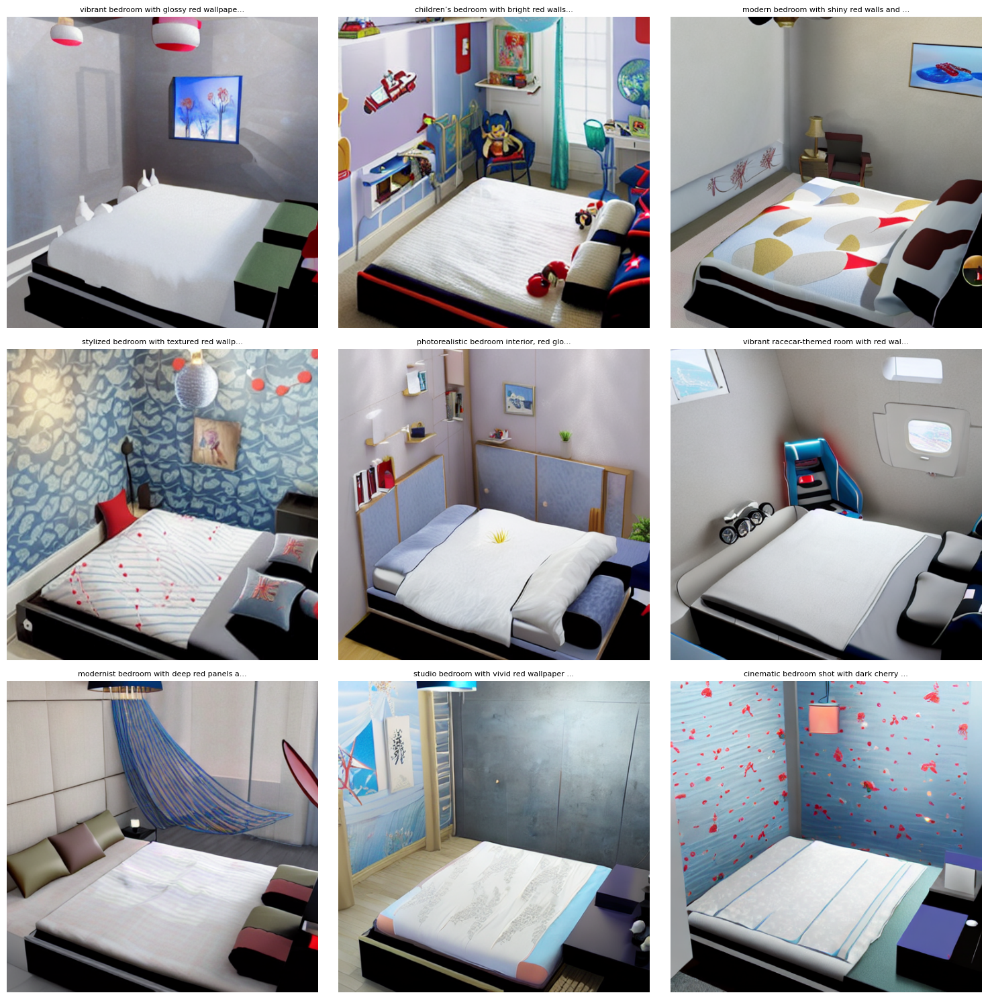

In [ ]:
import matplotlib.pyplot as plt
import random

# Enhance original image contrast and ensure RGB
from PIL import ImageEnhance
image = image.convert("RGB").resize((512, 512))
image = ImageEnhance.Contrast(image).enhance(1.8)

# Fixed parameters
strength = 0.62
guidance_scale = 12
num_inference_steps = 50
negative_prompt = "monochrome, grayscale, blurry, washed out, deformed, white walls, low saturation"

# Prompt variants (theme: red wallpaper + blue bed, but vary mood/details)
themes = [
    "vibrant bedroom with glossy red wallpaper and a sky-blue bed, oak floor, soft shadows, cinematic lighting",
    "children’s bedroom with bright red walls and a glossy cobalt bed, colorful carpet, Pixar style",
    "modern bedroom with shiny red walls and a rich blue comforter, white ceiling, ambient sunlight",
    "stylized bedroom with textured red wallpaper and royal blue bedding, soft rim lighting",
    "photorealistic bedroom interior, red glossy walls, navy blue bed, window light, minimal furniture",
    "vibrant racecar-themed room with red walls and a bright blue racecar bed, high contrast lighting",
    "modernist bedroom with deep red panels and a soft blue bed, strong lighting, saturated tones",
    "studio bedroom with vivid red wallpaper and a blue platform bed, soft light bounce",
    "cinematic bedroom shot with dark cherry red walls and deep blue covers, glow from window"
]

# Generate images
fig, axes = plt.subplots(3, 3, figsize=(15, 15))
outputs = []

for ax, prompt in zip(axes.flatten(), themes):
    result = pipe(
        prompt=prompt,
        image=image,
        strength=strength,
        guidance_scale=guidance_scale,
        num_inference_steps=num_inference_steps,
        negative_prompt=negative_prompt
    ).images[0]

    outputs.append(result)
    ax.imshow(result)
    ax.axis("off")
    ax.set_title(prompt[:40] + "...", fontsize=8)

plt.tight_layout()
plt.show()

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

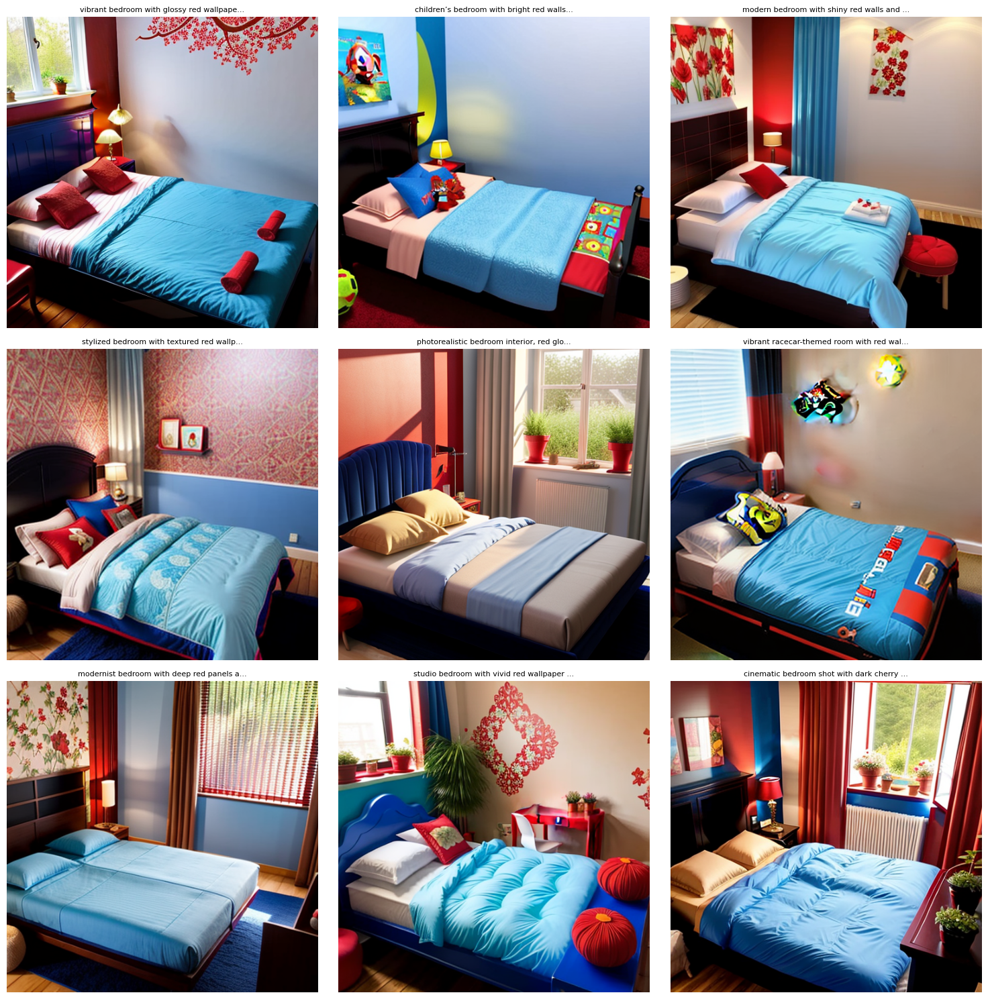

In [ ]:
import matplotlib.pyplot as plt
import random

image = Image.open("Untitled4.png").convert("RGB")

# Enhance original image contrast and ensure RGB
from PIL import ImageEnhance
image = image.convert("RGB").resize((512, 512))
image = ImageEnhance.Contrast(image).enhance(1.8)

# Fixed parameters
strength = 0.72
guidance_scale = 16
num_inference_steps = 50
negative_prompt = "monochrome, grayscale, blurry, washed out, deformed, white walls, low saturation, tv, television"

# Prompt variants (theme: red wallpaper + blue bed, but vary mood/details)
themes = [
    "vibrant bedroom with glossy red wallpaper and a sky-blue bed, oak floor, soft shadows, cinematic lighting, flowerpot",
    "children’s bedroom with bright red walls and a glossy cobalt bed, colorful carpet, Pixar style, flowerpot",
    "modern bedroom with shiny red walls and a rich blue comforter, white ceiling, ambient sunlight, flowerpot",
    "stylized bedroom with textured red wallpaper and royal blue bedding, soft rim lighting, flowerpot",
    "photorealistic bedroom interior, red glossy walls, navy blue bed, window light, minimal furniture, flowerpot",
    "vibrant racecar-themed room with red walls and a bright blue racecar bed, high contrast lighting, flowerpot",
    "modernist bedroom with deep red panels and a soft blue bed, strong lighting, saturated tones, flowerpot",
    "studio bedroom with vivid red wallpaper and a blue platform bed, soft light bounce, flowerpot",
    "cinematic bedroom shot with dark cherry red walls and deep blue covers, glow from window, flowerpot"
]

# Generate images
fig, axes = plt.subplots(3, 3, figsize=(15, 15))
outputs = []

for ax, prompt in zip(axes.flatten(), themes):
    result = pipe(
        prompt=prompt,
        image=image,
        strength=strength,
        guidance_scale=guidance_scale,
        num_inference_steps=num_inference_steps,
        negative_prompt=negative_prompt
    ).images[0]

    outputs.append(result)
    ax.imshow(result)
    ax.axis("off")
    ax.set_title(prompt[:40] + "...", fontsize=8)

plt.tight_layout()
plt.show()


# Dreamlike Photoreal 2.0

In [ ]:
!pip install diffusers transformers accelerate safetensors

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 86.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 45.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 48.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 36.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 16.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 90.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitli

In [ ]:
from diffusers import StableDiffusionImg2ImgPipeline
import torch

# Load Dreamlike Photoreal 2.0
pipe_dp = StableDiffusionImg2ImgPipeline.from_pretrained(
    "dreamlike-art/dreamlike-photoreal-2.0",
    torch_dtype=torch.float16,
    safety_checker=None
).to("cuda")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/511 [00:00<?, ?B/s]

Fetching 12 files:   0%|          | 0/12 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/901 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/807 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/341 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/577 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

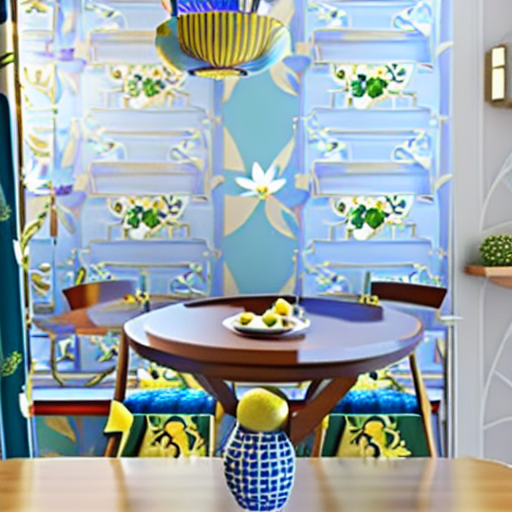

In [ ]:
import os
from PIL import Image
from IPython.display import display

# a) Load & prep the image
data_dir = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset"
cat, fname = "living_room", "0128-0104_4.png"
image = Image.open(os.path.join(data_dir, cat, fname)).convert("RGB")
image = image.resize((512, 512))

# b) Set your prompts & params
prompt          = "Mediterranean-style dining room with green and yellow patterned wallpaper, a blue dining table with a bowl of fruit and flowers, soft natural daylight, photorealistic"
negative_prompt = "monochrome, grayscale, blurry, washed out, deformed, white walls, low saturation, person, people, human, face, portrait"
strength        = 0.62
guidance_scale  = 20
num_steps       = 50

# c) Run the img2img
output_dp = pipe_dp(
    prompt=prompt,
    image=image,
    strength=strength,
    guidance_scale=guidance_scale,
    num_inference_steps=num_steps,
    negative_prompt=negative_prompt
).images[0]

# d) Save & display
output_dp.save("output_dp.png")
display(output_dp)


  0%|          | 0/30 [00:00<?, ?it/s]

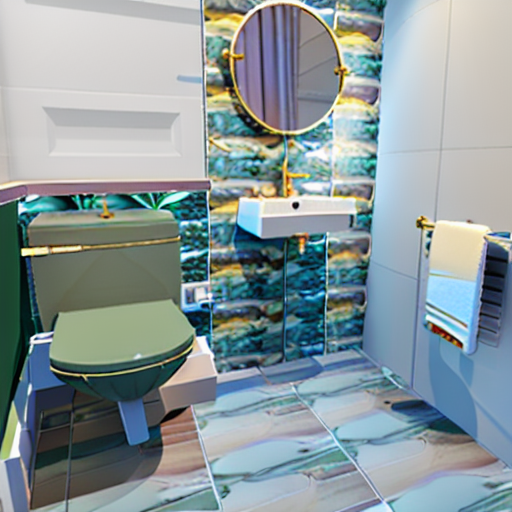

In [ ]:
import os
from PIL import Image
from IPython.display import display

# a) Load & prep the image
data_dir = "/content/drive/MyDrive/Computer Vision/FloorPlanCAD Dataset"
cat, fname = "bathroom", "0126-0009_1.png"
image = Image.open(os.path.join(data_dir, cat, fname)).convert("RGB")
image = image.resize((512, 512))

# b) Set your prompts & params
prompt          = "large luxurious bathroom with dark green tiled wall, gold finishes, large plant, white light fixture, white tiled floor"
negative_prompt = "monochrome, grayscale, blurry, washed out, deformed, white walls, low saturation, person, people, human, face, portrait"
strength        = 0.6
guidance_scale  = 25
num_steps       = 50

# c) Run the img2img
output_dp = pipe_dp(
    prompt=prompt,
    image=image,
    strength=strength,
    guidance_scale=guidance_scale,
    num_inference_steps=num_steps,
    negative_prompt=negative_prompt
).images[0]

# d) Display
display(output_dp)